# Object Recognition
Object recognition is general term to describe a variety of tasks that can be performed with computer vision.It involves:
- Imgage Classification
- Object Localization
- Object detection

In beggining it's difficult to understand those task related to computer vision. like image classification refers to the task to assigning a lable to the image, whereas object localization involves drawing a bounding box around one or more objects in an image. Object detection is more challenging as it involves both of these tasks.

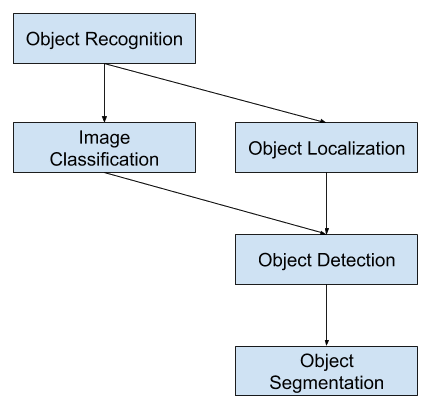


In object detection algorithms produce a list of object categories present in an image along with an axis aligned bounding box indicating the position and scale of every instance of each category.

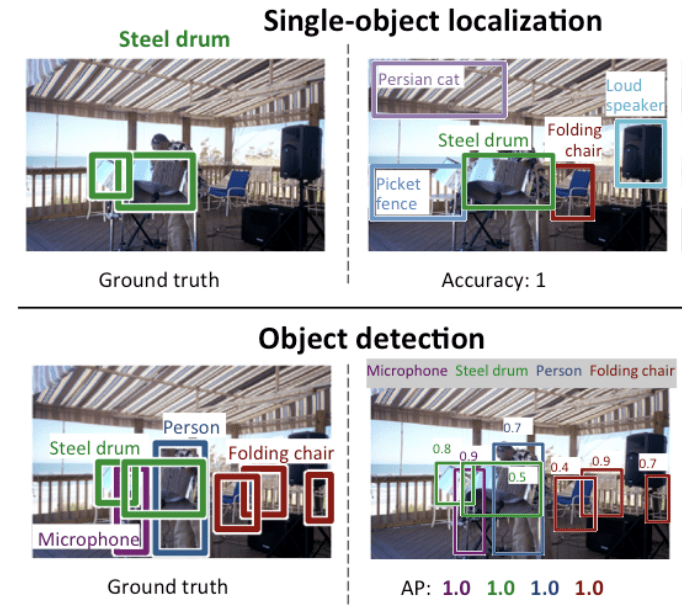

### Image classification for NEU Dataset.
So here first we will implement Image classification for our dataset and see if model is able to correctly classify the images in every class that is **patches**, **scratches**, **pitted-surface**, **rolled_in_scale**, **crazing** and **inclusion**.
Here will use Transfer learning to classify the images as the images per class is less around 240 and validation is around 60 each class.

In [ ]:
!pip install kaggle

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!mkdir ~/.kaggle # make a directory named kaggle

In [ ]:
!cp kaggle.json ~/.kaggle/  # copy the json file into this directory

cp: cannot stat 'kaggle.json': No such file or directory


In [ ]:
!kaggle datasets download kaustubhdikshit/neu-surface-defect-database  # downloading the whole dataset to our colab notebook

 19% 5.00M/26.4M [00:00<00:00, 45.0MB/s]
100% 26.4M/26.4M [00:00<00:00, 140MB/s] 


In [ ]:
!unzip neu-surface-defect-database.zip  ## to unzip our data

In [ ]:
## Necessary imports for image classification
import tensorflow as tf
tf.__version__
import numpy as np

# for directory manipulation and randomization
import random
import pathlib

# data loading
from keras.preprocessing.image import ImageDataGenerator

# Model
from keras.models import Sequential, load_model
from keras.layers import Dense

In [ ]:
train_directory = pathlib.Path("/content/NEU-DET/train/images")
Dclasses = np.array(sorted([item.name for item in train_directory.glob("*")]))
print(f" Total number of classes in dataset are: {len(Dclasses)} \nClass : {Dclasses}")

 Total number of classes in dataset are: 6 
Class : ['crazing' 'inclusion' 'patches' 'pitted_surface' 'rolled-in_scale'
 'scratches']


In [ ]:
# Setting up our directories
import os

train_crazing_dir = os.path.join('/content/NEU-DET/train/images/crazing')
train_inclusion_dir = os.path.join('/content/NEU-DET/train/images/inclusion')
train_patches_dir = os.path.join('/content/NEU-DET/train/images/patches')
train_pitted_surface_dir = os.path.join('/content/NEU-DET/train/images/pitted_surface')
train_rolledin_scale_dir = os.path.join('/content/NEU-DET/train/images/rolled-in_scale')
train_scratches_dir = os.path.join('/content/NEU-DET/train/images/scratches')

In [ ]:
train_crazing_names = os.listdir(train_crazing_dir)
train_inclusion_names = os.listdir(train_inclusion_dir)
train_patches_names = os.listdir(train_patches_dir)
train_pitted_surface_names = os.listdir(train_pitted_surface_dir)
train_rolledin_scale_names = os.listdir(train_rolledin_scale_dir)
train_scratches_names = os.listdir(train_scratches_dir)

In [ ]:
# check the number of images in all the directories
print(f"The number of images for training in Crazing defect is: {len(train_crazing_names)}")
print(f"The number of images for training in Inclusion defect is: {len(train_inclusion_names)}")
print(f"The number of images for training in Patches defect is: {len(train_patches_names)}")
print(f"The number of images for training in Pitted surface defect is: {len(train_pitted_surface_names)}")
print(f"The number of images for training in Rolled-in scale defect is: {len(train_rolledin_scale_names)}")
print(f"The number of images for training in scratches defect is: {len(train_scratches_names)}")

The number of images for training in Crazing defect is: 240
The number of images for training in Inclusion defect is: 240
The number of images for training in Patches defect is: 240
The number of images for training in Pitted surface defect is: 240
The number of images for training in Rolled-in scale defect is: 240
The number of images for training in scratches defect is: 240


Funtion to view any image with its directory and the defect name

In [ ]:
import matplotlib.pyplot as plt
def img_preview(dir, defect):
  '''
  Takes the directory and the defect as input and randomly select an image to preview from that folder.
  ** args **
  dir = the name of directory without the defect folder.
  defect = name of the defect in string
  '''

  folder = os.path.join(dir + '/' + defect)  # target images
  random_img = random.sample(os.listdir(folder), 1)  # selecting the random image
  # print(random_img)

  img = plt.imread(folder + '/' + random_img[0])
  #print(img.shape)
  plt.imshow(img)
  plt.legend(defect)
  plt.axis("off")
  return img

array([[[119, 119, 119],
        [114, 114, 114],
        [119, 119, 119],
        ...,
        [ 83,  83,  83],
        [ 92,  92,  92],
        [ 84,  84,  84]],

       [[102, 102, 102],
        [101, 101, 101],
        [107, 107, 107],
        ...,
        [ 90,  90,  90],
        [100, 100, 100],
        [ 77,  77,  77]],

       [[108, 108, 108],
        [ 94,  94,  94],
        [101, 101, 101],
        ...,
        [ 94,  94,  94],
        [ 91,  91,  91],
        [ 80,  80,  80]],

       ...,

       [[160, 160, 160],
        [178, 178, 178],
        [171, 171, 171],
        ...,
        [ 92,  92,  92],
        [ 76,  76,  76],
        [ 71,  71,  71]],

       [[156, 156, 156],
        [184, 184, 184],
        [167, 167, 167],
        ...,
        [ 77,  77,  77],
        [ 75,  75,  75],
        [ 72,  72,  72]],

       [[153, 153, 153],
        [163, 163, 163],
        [172, 172, 172],
        ...,
        [ 69,  69,  69],
        [ 90,  90,  90],
        [ 78,  78,  78]]

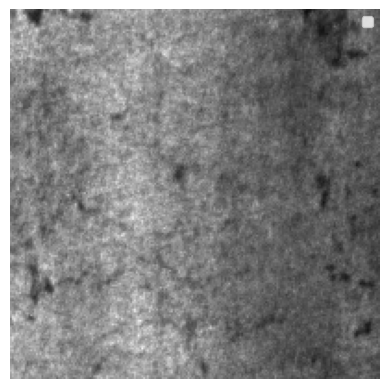

In [ ]:
img_preview("/content/NEU-DET/train/images", "crazing")

# Transfer learning
As each species of birds don't have the right amount of images for model to fully grasp the features that are needed to correctly predict the class of a bird. So we will use the pretrained models. The First we will try is VGG16 trained on millions of images on Imagenet dataset.

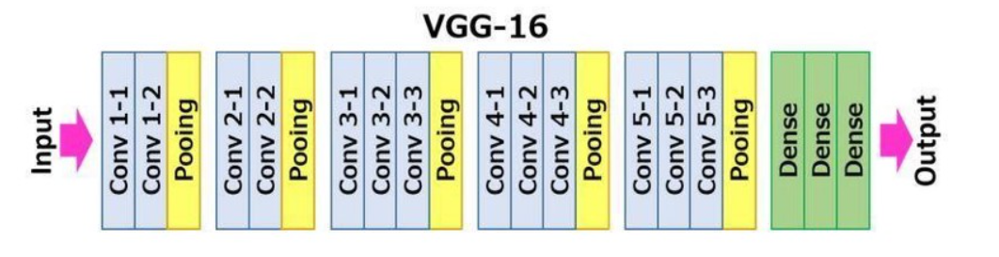

In [ ]:
from tensorflow.keras.applications import VGG16  # importing VGG16 from keras applications


In [ ]:
# defining the model
base_model = VGG16(include_top= False, weights= "imagenet", input_shape = (224,224,3))

58889256/58889256 [==============================] - 0s 0us/step


In [ ]:
# checking the model whether it has be correctly loaded or not
base_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

As we can see from our downloaded model above we don't have the top and last layer of the model, it is because it was made to classify for 1000 classes. Now what we will do is freeze our model so that we will not lose the important information it has on the previous million images training.

In [ ]:
# As we're using the pretrained model so we would want to preserve the learning it had from millions of images and use it for task in hand.
# so here we will freeze its layer for further training and use it as an feature extractor

base_model.trainable = False  # it is very important step

In [ ]:
import keras
# creating our own input and output according to our problem in hand
inputs = keras.layers.Input(shape=(224,224,3))
x = base_model(inputs)
x = keras.layers.GlobalAveragePooling2D()(x)
outputs = keras.layers.Dense(6, activation = "softmax")(x)  # creating the output by adding a final layer
model = keras.Model(inputs, outputs)  # putting all the pieces together

In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 global_average_pooling2d (G  (None, 512)              0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 6)                 3078      
                                                                 
Total params: 14,717,766
Trainable params: 3,078
Non-trainable params: 14,714,688
_________________________________________________________________


That is the magic of Transfer learning our model has only 3078 trainable parameters.

Here now is the time of compiling the model
Optimizer: Adam(adaptive momentum) it imparts the momentum to convergence with learning rate of 0.01.\
Loss Criterion: We will be using negative log-likelihood which is categorical cross entroy loss.\
Metrics : our metric will be accuracy

In [ ]:
# compiling the model
model.compile(loss = "categorical_crossentropy", optimizer="adam", metrics = ["accuracy"])

Setting up our Data and data loaders
a DataLoader is a utility class that helps to load and preprocess data in a way that can be efficiently fed into a neural network for training or evaluation. The DataLoader class is part of the tf.keras.preprocessing module in TensorFlow 2.

It allows us to:
- Efficiently load large datasets from disk or other storage locations, and preprocess them in parallel with multiple CPU cores.
- Transform input data into a format that can be consumed by a neural network model, such as converting data into tensors and applying normalization, data augmentation, or other preprocessing techniques.
- Create batches of data and feed them to a model for training or evaluation.

To use DataLoader, you typically create an instance of the ImageDataGenerator class, which defines the preprocessing and data augmentation pipeline, and then call the flow_from_directory method to load and preprocess the data.


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale = 1./255)  # creating an instance

train_data = train_datagen.flow_from_directory(
    directory = "/content/NEU-DET/train/images",
    batch_size = 32,
    target_size = (224,224),
    class_mode = "categorical",
    shuffle = True
)

val_data = train_datagen.flow_from_directory(
    directory = "/content/NEU-DET/validation/images",
    batch_size = 32,
    target_size = (224, 224),
    class_mode = 'categorical',
    shuffle = False
)

Found 1440 images belonging to 6 classes.
Found 360 images belonging to 6 classes.


In [ ]:
len(train_data)

45

### Training the model(on GPU)

In [ ]:
history = model.fit(
    train_data,
    steps_per_epoch=32,
    epochs=50,
    verbose=1,
    validation_data = val_data,
    shuffle=True
)

Epoch 1/50
32/32 [==============================] - 21s 226ms/step - loss: 1.6945 - accuracy: 0.3711 - val_loss: 1.5414 - val_accuracy: 0.5833
Epoch 2/50
32/32 [==============================] - 6s 174ms/step - loss: 1.3920 - accuracy: 0.6709 - val_loss: 1.3409 - val_accuracy: 0.7472
Epoch 3/50
32/32 [==============================] - 6s 175ms/step - loss: 1.2052 - accuracy: 0.8525 - val_loss: 1.1910 - val_accuracy: 0.7972
Epoch 4/50
32/32 [==============================] - 6s 177ms/step - loss: 1.0403 - accuracy: 0.8955 - val_loss: 1.0720 - val_accuracy: 0.8194
Epoch 5/50
32/32 [==============================] - 6s 176ms/step - loss: 0.9273 - accuracy: 0.8857 - val_loss: 0.9773 - val_accuracy: 0.8361
Epoch 6/50
32/32 [==============================] - 6s 182ms/step - loss: 0.8336 - accuracy: 0.9004 - val_loss: 0.8981 - val_accuracy: 0.8750
Epoch 7/50
32/32 [==============================] - 6s 182ms/step - loss: 0.7492 - accuracy: 0.9121 - val_loss: 0.8273 - val_accuracy: 0.8750
Epoch

### Plotting loss and accuracy curves

In [ ]:
def vis_plot(history):
    '''
    This function takes 1 argument "history" which is generated while training and model and plot the loss and accuracy curves,
    against the epochs model was trained with
    '''

    loss = history.history["loss"]
    val_loss = history.history["val_loss"]

    accuracy = history.history["accuracy"]
    val_accuracy = history.history["val_accuracy"]

    epochs = range(len(history.history["loss"]))

    plt.plot(epochs, loss, label = "training_loss")
    plt.plot(epochs, val_loss, label = "val_loss")
    plt.title("Loss")
    plt.plot("epochs")
    plt.legend()

    plt.figure()
    plt.plot(epochs, accuracy, label = "training_accuracy")
    plt.plot(epochs, val_accuracy, label = "val_accuracy")
    plt.title("Accuracy")
    plt.xlabel("epochs")
    plt.legend()
    plt.show()
    plt.tight_layout()

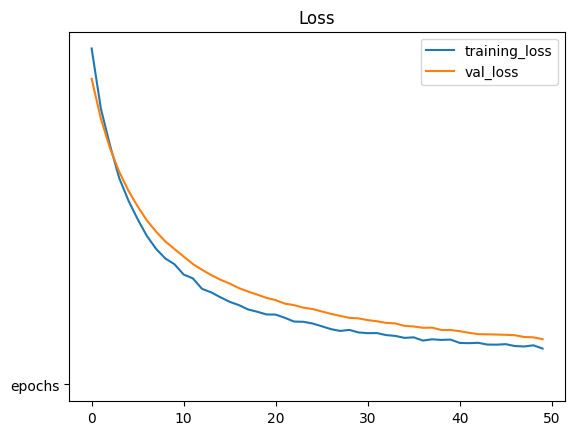

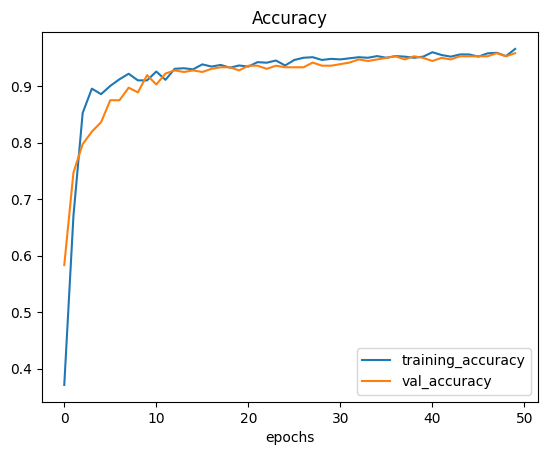

<Figure size 640x480 with 0 Axes>

In [ ]:
vis_plot(history)

In [ ]:
# accuracy and loss curves looks good. Now let's save our model for future use
model.save("metal_defect_model.h5")


In [ ]:
from keras.models import load_model
new_model = load_model("/content/metal_defect_model.h5")

Evaluation on the train and test data

In [ ]:
## Evaluation of model on train and val sets
Eval_train = model.evaluate(train_data)

45/45 [==============================] - 7s 139ms/step - loss: 0.1821 - accuracy: 0.9604


In [ ]:
Eval_val = model.evaluate(val_data)  # eval on validation data

12/12 [==============================] - 2s 123ms/step - loss: 0.2287 - accuracy: 0.9583


Predicting again with validation data on loaded model.

In [ ]:
Eval_val = new_model.evaluate(val_data)  # eval on validation data

12/12 [==============================] - 2s 114ms/step - loss: 0.2287 - accuracy: 0.9583


In [ ]:
# predicting the test set
# we will use np.argmax to use our most probable prediction.
pred = new_model.predict(val_data)
pred = np.argmax(pred, axis =1)

12/12 [==============================] - 15s 242ms/step


### Prediction
Let's make a prediction on any random image related to the val dataset


True label : crazing
Predicted label is: crazing


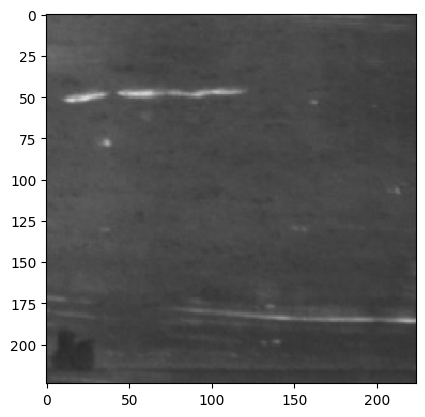

In [ ]:
import matplotlib.pyplot as plt
ind = 9  # random index
img, label = val_data[ind]  # getting img and labels
label = val_data.labels[ind]
print(f'True label : {Dclasses[label]}')
print(f'Predicted label is: {Dclasses[pred[ind]]}')
plt.imshow(img[0])
plt.show()

# Surface image detection with NEU Dataset.
As we can see in above model that our image classification model is working well. Now let's move on to our task or object detection of the mentioned classes and see how our model works.
Here we will be using Tensorflow 2.

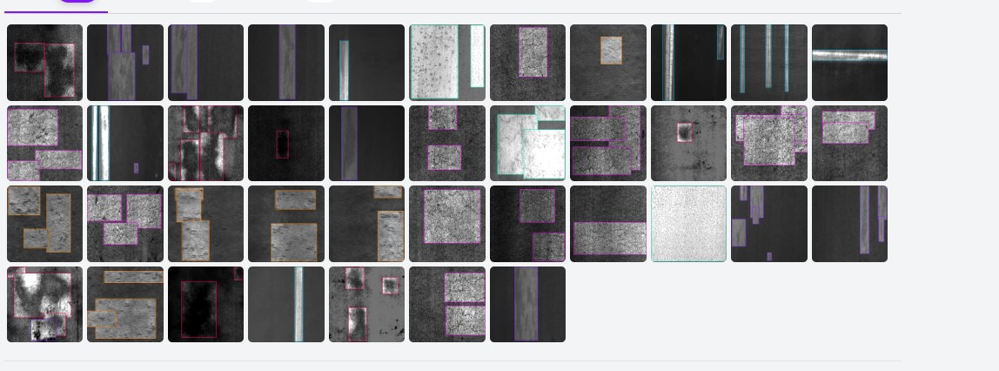

In [ ]:
!pip install kaggle

In [ ]:
!mkdir ~/.kaggle # make a directory named kaggle

In [ ]:
!cp kaggle.json ~/.kaggle/  # copy the json file into this directory

In [ ]:
!chmod 600 ~/.kaggle/kaggle.json  # required permission for the file

In [ ]:
!kaggle datasets download kaustubhdikshit/neu-surface-defect-database  # downloading the whole dataset to our colab notebook

 64% 17.0M/26.4M [00:00<00:00, 51.7MB/s]
100% 26.4M/26.4M [00:00<00:00, 72.1MB/s]


In [ ]:
!unzip neu-surface-defect-database.zip  ## to unzip our data

### Project description
Here everything is performed in google colab. Some of manual changes is required to be able to replicate the same results as were shown in this file. So currect use of directories is required.

In [ ]:
!pip install tensorflow

### 1. Download Tensorflow model garden
Model Garden is an official TensorFlow repository on github.com. In this step we want to clone this repo to our local machine.

Make sure that you’re located in the Tensorflow directory.

In [ ]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3733, done.
remote: Counting objects: 100% (3733/3733), done.
remote: Compressing objects: 100% (2873/2873), done.
remote: Total 3733 (delta 1061), reused 1797 (delta 810), pack-reused 0
Receiving objects: 100% (3733/3733), 48.76 MiB | 26.90 MiB/s, done.
Resolving deltas: 100% (1061/1061), done.


### 2. Download, install and compile protobuf
By default, the TensorFlow Object Detection API uses Protobuf to configure model and training parameters, so we need this library to move on.\
Here we compiles the Protocol Buffer files in object_detection/protos/ using the protoc compiler. Protocol Buffers are a language- and platform-neutral mechanism for serializing structured data, and they are used by the TensorFlow Object Detection API to define the structure of objects that are passed between the different components of the system. The --python_out flag specifies the output directory for the generated Python code, which is set to the current working directory (.).\

Copies the setup.py file from object_detection/packages/tf2/ to the current working directory. The setup.py file is used to install the TensorFlow Object Detection API as a Python package, and it is required to be in the same directory as the object_detection module in order for the installation to work correctly.


In [ ]:
# Install the Object Detection API
# set up the environment for using the TensorFlow Object Detection API, by compiling the Protocol Buffer files and copying the setup.py file to the appropriate location.
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Test the TensorFlow object Detection API installation.\
The script tests the creation of several object detection models, such as Faster R-CNN, SSD, and CenterNet, using various feature extractors, such as ResNet50 and EfficientNet. It verifies that the models can be built successfully and that their output shapes match the expected shapes. It also tests the creation of anchor generators, box predictors, and other components used in object detection models.

it it runs smoothly that means API was correctly installed and ready to use

In [ ]:
#run model builder test
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

2023-04-25 15:22:00.261824: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-25 15:22:01.665626: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.9/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
2023-04-25 15:22:04.939028: I tensorflow

It seems like every thing is fine till now let's move on

### 3. Data Preparation
Models based on the TensorFlow object detection API need a special format for all input data, called TFRecord., but first let’s talk about a few assumptions about your data availability and its annotations.

We already have data (images) collected for model training, and Validation.
We've the Neu-Det folder containing train and test folder each having the 6 folder for our 6 classes"Patches, Scratches, inclusion, rolled-in-scale, pitted-surface and crazing", All folder contains images along with the annotation of images. Although images are in differnt folder other than annotations but their names are same(only difference is the extension which is .xml for annotations)

Your images are annotated for object detection, meaning that regions for all objects of interest that might be presented in your datasets are manually defined as bounding boxes, and ground truth labels are set for each and every box.

Loading the data by OS module to load the filename for the images and their corresponding annotation files.

In [ ]:

Image_dir = "/content/NEU-DET/train/images"
Annotation_dir = "/content/NEU-DET/train/annotations"

### Tensorflow records
TensorFlow Records, also known as TFRecords, are a file format used by TensorFlow for efficient storage and retrieval of large datasets. TFRecords are a binary file format that stores a sequence of serialized protocol buffers, which can be read and parsed efficiently using TensorFlow's built-in input pipeline functions.\
In the context of object detection, TFRecords are commonly used to store the training and validation datasets for the object detection model. Each TFRecord file contains a series of serialized tf.train.Example protocol buffers, where each Example contains an image and its associated annotations, such as the bounding boxes and class labels of the objects in the image.

https://towardsdatascience.com/image-data-labelling-and-annotation-everything-you-need-to-know-86ede6c684b1

In [ ]:
# creating a TFRecord format.
!pip install tensorflow object_detection
from object_detection.utils import dataset_util
import xml.etree.ElementTree as ET

In [ ]:
import os
image_files = [os.path.join(Image_dir, file) for file in os.listdir(Image_dir)]  # creating a list of directory of each class
annotation_files = [os.path.join(Annotation_dir, file) for file in os.listdir(Annotation_dir)]

Creating TFRrecord from Roboflow API
Here we used the Roboflow API to create the TFRrecord for Train and validation set which will directly be download to colab with the code mentioned below.
https://blog.roboflow.com/create-tfrecord/

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="WDXRMhcFN9JxtepLvdDe")  # API key for my Account()
project = rf.workspace("university-of-napoli").project("object-detection-of-metal-surface-defects")
dataset = project.version(1).download("tfrecord")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Object-detection-of-metal-surface-defects-1 in tfrecord:: 100%|██████████| 8/8 [00:01<00:00,  6.07it/s]


Creation of Label map
A Label Map is a simple .txt file (.pbtxt to be exact). It links labels to some integer values. The TensorFlow Object Detection API needs this file for training and detection purposes.

In order to understand how to create this file, let’s look at a simple example where we want to detect only 2 classes: cars and bikes. Nothing else matters, just these two objects. Let’s look at how label_map.pbtxt will look like for such a task:
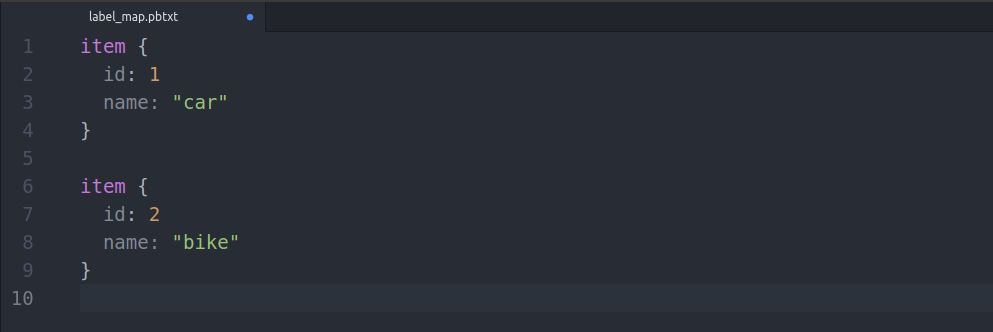

In [ ]:
Label_map = {"crazing": 1, "inclusion": 2, "patches": 3, "pitted_surface": 4, "rolled-in_scale": 5, "scratches": 6}
with open('label_map.pbtxt', 'w') as f:
    for class_name, class_id in Label_map.items():
        f.write('item {\n')
        f.write('  id: %d\n' % class_id)
        f.write("  name: '%s'\n" % class_name)
        f.write('}\n')

In [ ]:
!pip install tensorflow-object-detection-api
!pip show tensorflow-object-detection-api

Setting up the paths for training, validation and Labelmap, for model training.

In [ ]:
train_record_path = '/content/Object-detection-of-metal-surface-defects-1/train/Metal-surface-defects.tfrecord'
test_record_path = '//content/Object-detection-of-metal-surface-defects-1/test/Metal-surface-defects.tfrecord'
labelmap_path = '/content/Object-detection-of-metal-surface-defects-1/train/Metal-surface-defects_label_map.pbtxt'

## Model Selection and Configuration
In this part of the tutorial we want to do two things:\
- First, select a model architecture to work with. Luckily, there are plenty of options and all of them are awesome.
- Second, we will work on model configuration, so it can tackle a desired task, be efficient, work under resource constraints that you might experience, and have the ability to generalise well enough to be used in the real world.

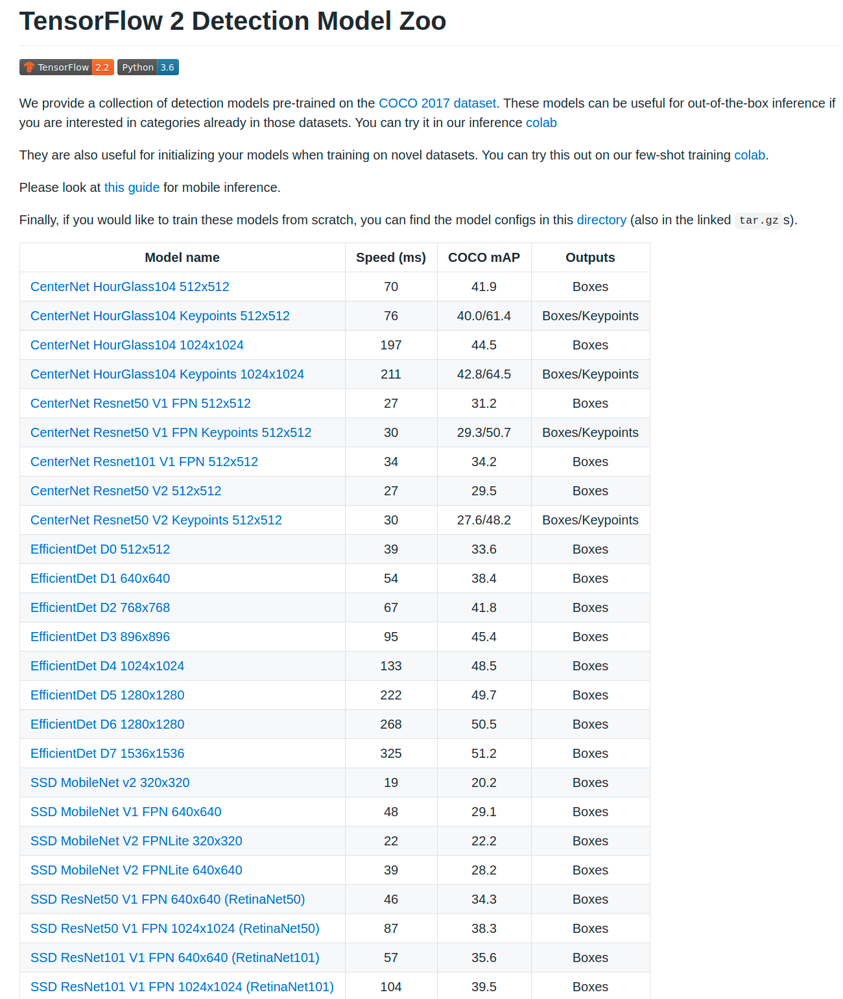

Now that the data is ready it's time to create a training configuration. The Object Detection API supports lots of models, each with its own config file. In this notebook we're making use of EfficientDet, but you can replace it with any model available in the [Tensorflow 2 Detection Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md)

Instead of training the model from scratch, we will do transfer learning from a model pre-trained to detect everyday objects.

Transfer learning requires less training data compared to training from scratch.

Here we're using **efficientdet_d0** pretrained model which is trained on defects as well so its better to use it for our case. In our case, the base model is trained with coco dataset of common objects, the 3 target objects we want to train the model to detect the defects in metal which are "Patches", "scratches", "inclusion", "rolled-in-scale", "pitted-surface" and "crazing". Coco dataset includes some defects like *scratches*, *dents*, *patches* etc.

To do the transfer learning training, we first will download the pre-trained model weights/checkpoints and then config the corresponding pipeline config file to tell the trainer about the following information.

the pre-trained model checkpoint path(fine_tune_checkpoint),
the path to those two tfrecord files,
path to the label_map.pbtxt file(label_map_path),
training batch size(batch_size)
number of training steps(num_steps)
number of classes of unique objects(num_classes)

In [ ]:
batch_size = 16
num_steps = 6000  # number of steps to train the model on
num_eval_steps = 1000

In [ ]:
fine_tune_checkpoint = 'efficientdet_d0_coco17_tpu-32/checkpoint/ckpt-0'  # setting up chekpoint path

Down loading the pretrained model

In [ ]:

!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
!tar -xf efficientdet_d0_coco17_tpu-32.tar.gz

--2023-04-25 15:29:21--  http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.217.218.128, 2a00:1450:4013:c08::80
Connecting to download.tensorflow.org (download.tensorflow.org)|172.217.218.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30736482 (29M) [application/x-tar]
Saving to: ‘efficientdet_d0_coco17_tpu-32.tar.gz’

efficientdet_d0_coc 100%[===================>]  29.31M  60.5MB/s    in 0.5s    

2023-04-25 15:29:22 (60.5 MB/s) - ‘efficientdet_d0_coco17_tpu-32.tar.gz’ saved [30736482/30736482]



Downloading the pipline file


In [ ]:
# getting our model pipeline
!wget https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config

base_config_path = 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config'

--2023-04-25 15:29:37--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4630 (4.5K) [text/plain]
Saving to: ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’

ssd_efficientdet_d0 100%[===================>]   4.52K  --.-KB/s    in 0s      

2023-04-25 15:29:37 (65.8 MB/s) - ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’ saved [4630/4630]



### Model Configuration
Modifying the pipeline according to our problem:

We downloaded and extracted a pre-trained model of our choice. Now we want to configure it. There might be multiple reasons why we want to do that. Here are the important reasons as why we need to do the configuration:
- Our problem domain and our dataset are different from the one that was used to train the original model: So we need a **custom object detector**.
- We have different number of objects classes to detect.
- The objects we try to detect might be completely different from what a pre-trained model was supposed to detect,
- You probably have less computational power to train a model, and this also should be taken into account.

There are plethora of reason to configure the model but for now I want you to remember that model configuration is a process that lets us tailor model-related artifacts (e.g. hyperparameters, loss function, etc) so that it can be trained (fine-tuned) to tackle detection for the objects that we’re interested in. That’s it.

The TensorFlow Object Detection API allows model configuration via the pipeline.config file that goes along with the pre-trained model.



### Configuration process
Here we will play with the hyperparameters to make model more efficient to our use.

Here are the model parameters in config file that we downloaded above: we have to change below mentioned parameters:
- **num_classes** : By default it is 90, we have to provide our number of classes we have and change it to 6.
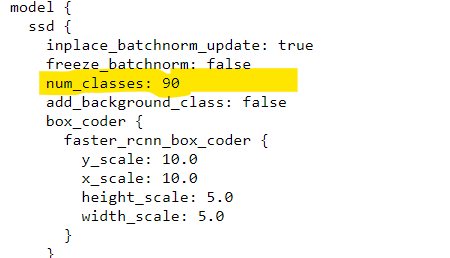

- **batch_size** : we left the batch size to be excatly same which is 128.
It has be changed in 2 places in config file "train_config" and "eval_config".
In train_config we will use 128 and in eval config we have to keep it same to be 1.

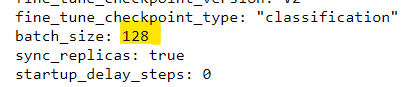
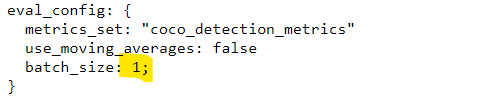

- **fine_tune_checkpoint(str)** : here we provide path to pretrained model checkpoint.

- **fine_tune_checkpoint_type(str)** : This field should be set to "detection" because we want to train a detection model.

- **label_map_path** : Here is where we provide a path to label label_map.pbtext that we've created before.
Label map path needs to be provided at 2 places in train_input_reader and eval_input.

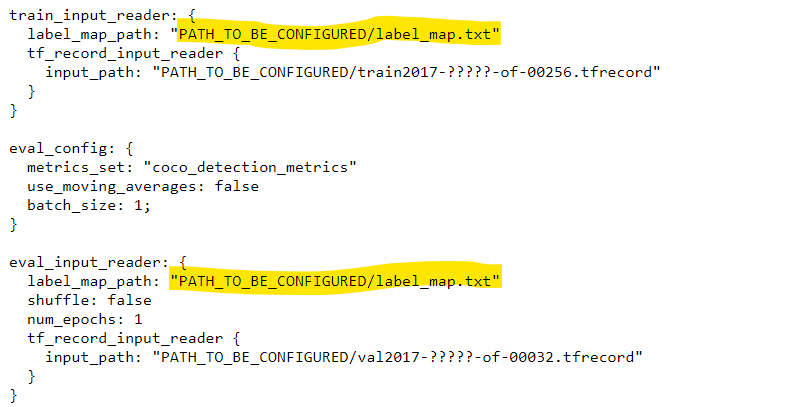

- **Input_path(str)** : Path to train.tfrrecord and val.tfrecord files path needs to go here. Train.tfrecord path will go in train_input_read and val.tfrecord will go to eval_input_reader.

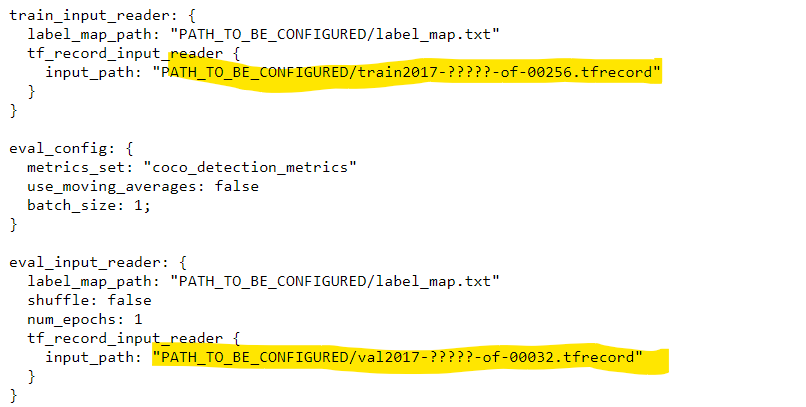

In [ ]:
import re

with open(base_config_path) as f:
    config = f.read()

with open('model_config.config', 'w') as f:

  # Set labelmap path
  config = re.sub('label_map_path: ".*?"',
             'label_map_path: "{}"'.format(labelmap_path), config)

  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                  'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), config)

  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")',
                  'input_path: "{}"'.format(train_record_path), config)

  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")',
                  'input_path: "{}"'.format(test_record_path), config)

  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  'num_classes: {}'.format(6), config)

  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  'batch_size: {}'.format(batch_size), config)

  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  'num_steps: {}'.format(num_steps), config)

  # Set fine-tune checkpoint type to detection
  config = re.sub('fine_tune_checkpoint_type: "classification"',
             'fine_tune_checkpoint_type: "{}"'.format('detection'), config)

  f.write(config)


As we can see below the changes we made are now reflected on our config file.
so we're good to go for training.


In [ ]:
%cat model_config.config  # to check if our changes are made or not


 # SSD with EfficientNet-b0 + BiFPN feature extractor,
# shared box predictor and focal loss (a.k.a EfficientDet-d0).
# See EfficientDet, Tan et al, https://arxiv.org/abs/1911.09070
# See Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from an EfficientNet-b0 checkpoint.
#
# Train on TPU-8

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 6
    add_background_class: false
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      m

Setting up directory to stor the model and checkpoint

In [ ]:
model_dir = 'training/'  # setting up directory of training checkpoint
pipeline_config_path = 'model_config.config'

Here on tensorboard we can see the live progress of model training as per the steps progress. In colab Tensorboard can be accessed with below mentioned piece of code. Scroll through several button and see differnt metrics.

In [ ]:
# Run this block first and use the refresh arrow that will appear in the header once the training below starts
%load_ext tensorboard
%tensorboard --logdir 'training/train'  # getting the live output on tensor board



<IPython.core.display.Javascript object>

### Training the model(for 8000 steps)
Due to GPU requirement model was stoped in 5000 steps.(training itself tool over 2 hours on GPU(Tesla T4))

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2023-04-25 15:30:43.888287: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-25 15:30:45.327460: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.9/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
2023-04-25 15:30:48.677327: I tensorflow

Lowest Classification loss achieved is around - 0.25

In [ ]:
output_directory = 'inference_graph'  # transferring the trained model checkpoint to another folder to download

!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_config_path}

2023-04-25 17:11:47.908690: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-25 17:11:49.940542: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.9/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
2023-04-25 17:11:55.281993: I tensorflow

### saving the model
Here we saved the model to our system.

In [ ]:
# Zip and download your new model to your system
from google.colab import files
!zip -r new_model.zip /content/{output_directory}/saved_model
files.download(f'new_model.zip')

  adding: content/inference_graph/saved_model/ (stored 0%)
  adding: content/inference_graph/saved_model/saved_model.pb (deflated 93%)
  adding: content/inference_graph/saved_model/fingerprint.pb (stored 0%)
  adding: content/inference_graph/saved_model/variables/ (stored 0%)
  adding: content/inference_graph/saved_model/variables/variables.index (deflated 78%)
  adding: content/inference_graph/saved_model/variables/variables.data-00000-of-00001 (deflated 36%)
  adding: content/inference_graph/saved_model/assets/ (stored 0%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!unzip new_model.zip  # uploading the model again to do the test of model on some images

In [ ]:
# install hte tensorrt for the inference
!apt-get install tensorrt

For Testing the model for test model we used the inference.py script which takes argument of *model*, *label_map* and the *test images*.
It will save the output of inference on output folder in the current directory.

In [ ]:

!python inference.py -m content/inference_graph/saved_model -l Metal-surface-defects_label_map.pbtxt -i models/research/object_detection/test_images/Test

In [ ]:
#!pip install tensorflow-object-detection-api
!dpkg-query -W tensorrt  # checking the version of tensorRT


tensorrt	8.6.0.12-1+cuda12.0


### Visualization on test
Here is visualization of model on some of images that belong to all 6 categories of defects. Some images were not caught by model maybe because the generalization ability of model is not good. Although it does very good job in identifying the types of defect.

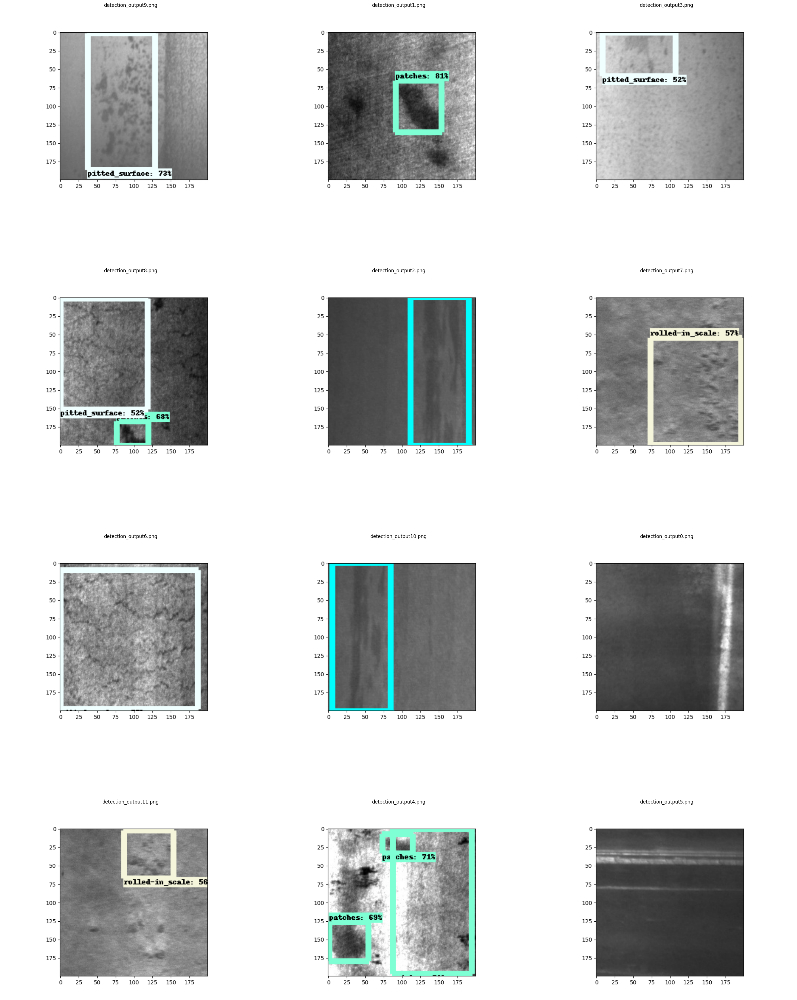

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Set the directory containing the images
img_dir = '/content/outputs/'

# Get a list of all image file names in the directory
img_files = os.listdir(img_dir)

# Create a figure with a grid of subplots
n_rows = 4
n_cols = (len(img_files) + 1) //   # Round up to nearest even number
fig, axs = plt.subplots(n_rows, n_cols, figsize=(n_cols * 12, n_rows * 12))

# Load and display each image in a subplot
for i, img_file in enumerate(img_files):
    # Load the image file
    img_path = os.path.join(img_dir, img_file)
    img = Image.open(img_path)

    # Compute the subplot index
    row_idx = i // n_cols
    col_idx = i % n_cols

    # Display the image in the corresponding subplot
    axs[row_idx, col_idx].imshow(img)
    axs[row_idx, col_idx].set_title(img_file)
    axs[row_idx, col_idx].axis('off')

# Adjust the spacing between subplots and show the figure
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.show()

# Alternatively:

We also trained the model using Roboflow from scratcg and there the results were better than this training and testing. Also we've deployed it on roboflow where it can do the real time check on the images.

We got the MAE of 66.3, precision of 57 and recall of 67.2 percent

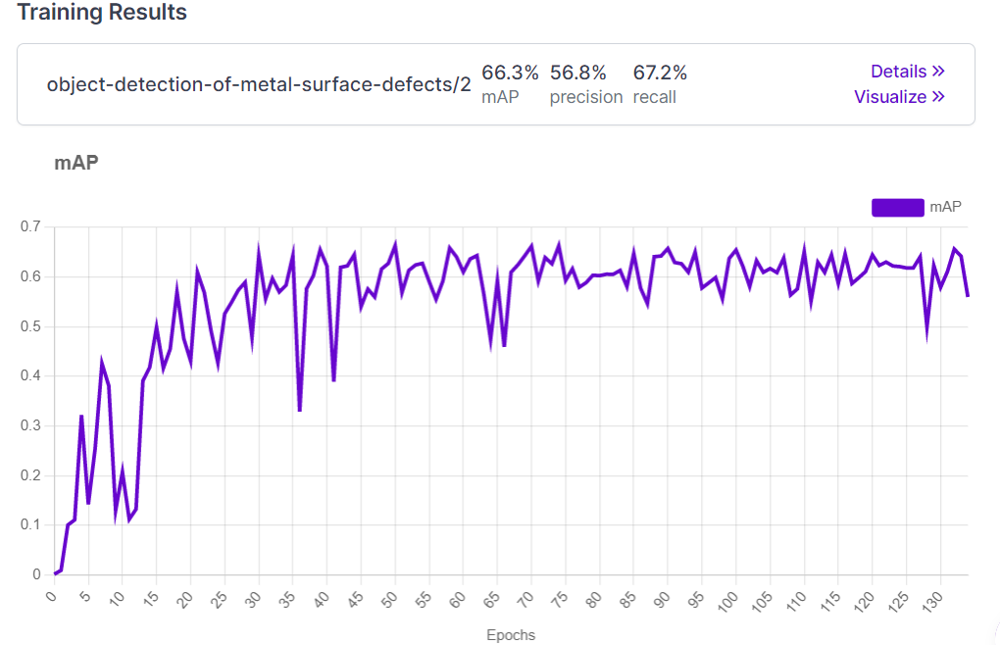

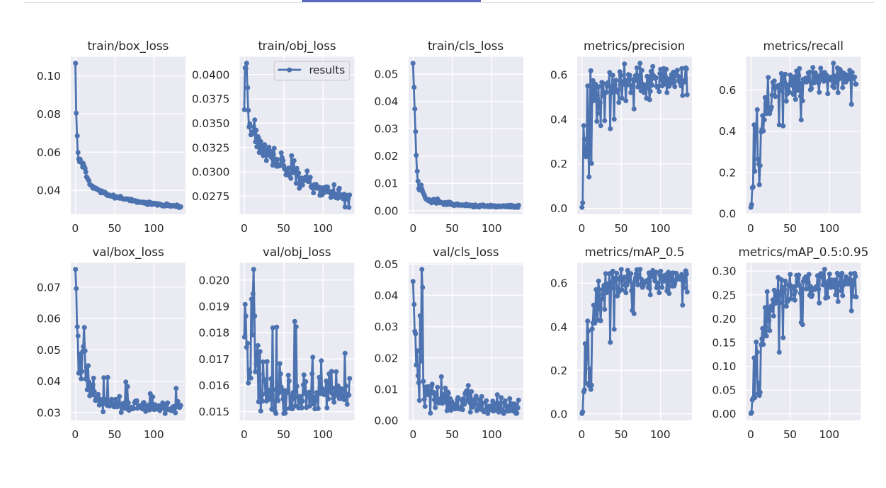

### Average precision by the classes.

[Here is the Link to project in RoboFlow. all mentioned graph in the notebook can be visualized interactively in this link](https://app.roboflow.com/university-of-napoli/object-detection-of-metal-surface-defects/2)


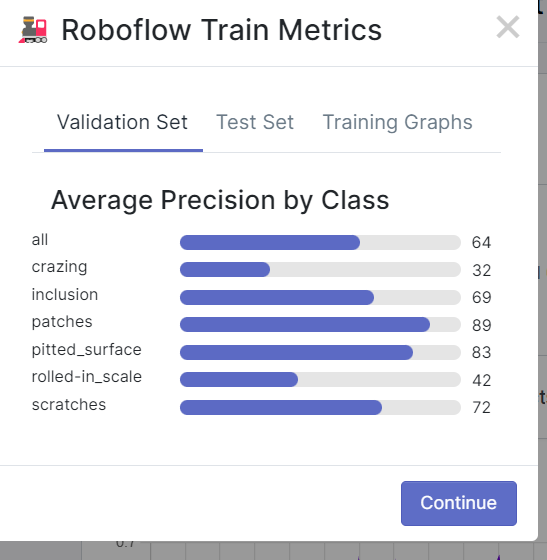

Link to the model in Roboflow:

In [ ]:
!unzip Test.zip

In [ ]:
!pip install roboflow

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="WDXRMhcFN9JxtepLvdDe")
project = rf.workspace().project("object-detection-of-metal-surface-defects")
model = project.version(2).model

# infer on a local image
print(model.predict("/content/Test/scratches_287.jpg", confidence=40, overlap=30).json())

# visualize your prediction
model.predict("/content/Test/scratches_287.jpg", confidence=40, overlap=30).save("prediction5.jpg")

# infer on an image hosted elsewhere
# print(model.predict("URL_OF_YOUR_IMAGE", hosted=True, confidence=40, overlap=30).json())

loading Roboflow workspace...
loading Roboflow project...
{'predictions': [{'x': 173.5, 'y': 100.0, 'width': 29.0, 'height': 200.0, 'confidence': 0.8306819200515747, 'class': 'scratches', 'image_path': '/content/Test/scratches_287.jpg', 'prediction_type': 'ObjectDetectionModel'}], 'image': {'width': '200', 'height': '200'}}


# Prediction

Prediction from Roboflow trained model. Here we also used the images that were missclassified on our pretrained model and we got some good results.

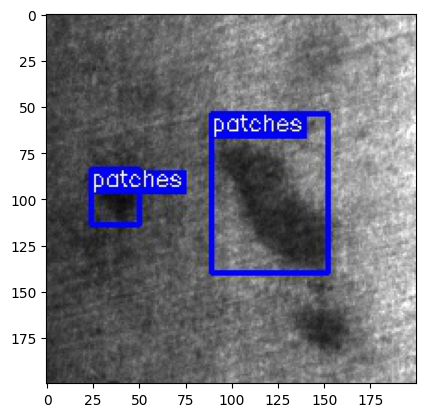

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load the image from file
img = mpimg.imread('prediction.jpg')

# Display the image using matplotlib
plt.imshow(img)
plt.show()

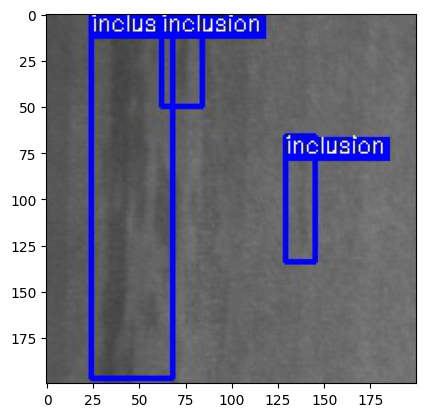

In [ ]:
# Load the image from file
img = mpimg.imread('prediction2.jpg')

# Display the image using matplotlib
plt.imshow(img)
plt.show()

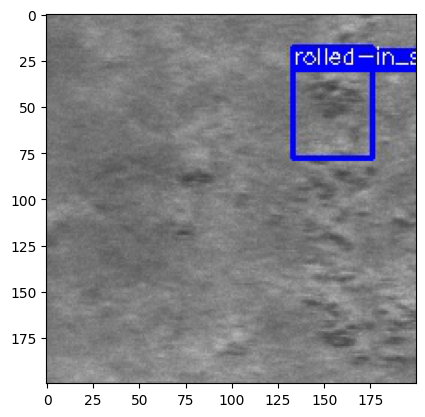

In [ ]:
# Load the image from file
img = mpimg.imread('prediction3.jpg')

# Display the image using matplotlib
plt.imshow(img)
plt.show()

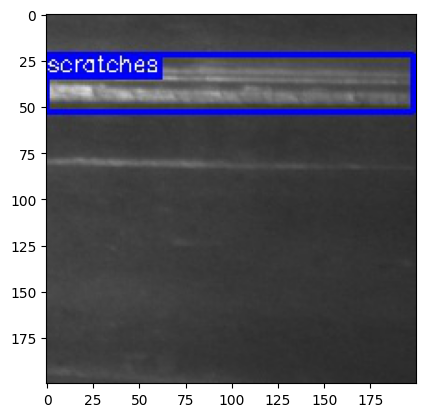

In [ ]:
# Load the image from file
img = mpimg.imread('prediction4.jpg')

# Display the image using matplotlib
plt.imshow(img)
plt.show()

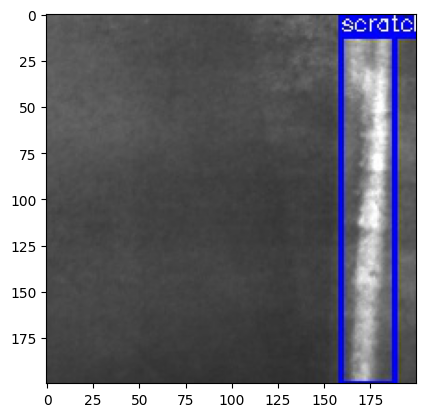

In [ ]:
# Load the image from file
img = mpimg.imread('prediction5.jpg')

# Display the image using matplotlib
plt.imshow(img)
plt.show()